# Cluster FICS

In [1]:
from dotenv import find_dotenv, load_dotenv
import os
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
from tqdm import tqdm
from tslearn.clustering import TimeSeriesKMeans
import time
from sklearn import metrics
from tslearn.clustering import TimeSeriesKMeans
from tslearn.clustering import silhouette_score
import numpy as np
from warnings import filterwarnings
import pickle
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from tslearn.utils import to_time_series_dataset
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

filterwarnings("ignore")



Variables

In [2]:
load_dotenv(find_dotenv())

PROJECT_PATH=os.getenv('PROJECT_PATH')
NUMBER_OF_GAMES_MINIMUM=int(os.getenv('NUMBER_OF_GAMES_MINIMUM'))
FICS_MIN_YEAR=int(os.getenv('FICS_MIN_YEAR'))
FICS_MAX_YEAR=int(os.getenv('FICS_MAX_YEAR'))



#### Methods

In [3]:
def get_samples(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        try:
            v=players_dict[p]
            arr=list(v[(v.index<offset+num_samples)&(v.index>=offset)]["Elo"])
            samples[p]=arr
        except Exception as err:
            print(err)
            pass
        
    for p in list(samples.keys()):
        if len(samples[p])!=num_samples:
            del samples[p]

    
    return samples

def get_samples_ts(players_dict,offset,num_samples):
    samples={}
    for p in players_dict:
        try:
            v=players_dict[p]
            arr_Timestamp=(v[(v.index<offset+num_samples)&(v.index>=offset)]["Timestamp"])
            samples[p]=arr_Timestamp
        except Exception as err:
            print(err)
            pass
        
    for p in list(samples.keys()):
        if len(samples[p])!=num_samples:
            del samples[p]

    print(samples)
    return samples

def dp(dist_mat):
    """
    Find minimum-cost path through matrix `dist_mat` using dynamic programming.

    The cost of a path is defined as the sum of the matrix entries on that
    path. See the following for details of the algorithm:

    - http://en.wikipedia.org/wiki/Dynamic_time_warping
    - https://www.ee.columbia.edu/~dpwe/resources/matlab/dtw/dp.m

    The notation in the first reference was followed, while Dan Ellis's code
    (second reference) was used to check for correctness. Returns a list of
    path indices and the cost matrix.
    """

    N, M = dist_mat.shape

    # Initialize the cost matrix
    cost_mat = np.zeros((N + 1, M + 1))
    for i in range(1, N + 1):
        cost_mat[i, 0] = np.inf
    for i in range(1, M + 1):
        cost_mat[0, i] = np.inf

    # Fill the cost matrix while keeping traceback information
    traceback_mat = np.zeros((N, M))
    for i in range(N):
        for j in range(M):
            penalty = [
                cost_mat[i, j],      # match (0)
                cost_mat[i, j + 1],  # insertion (1)
                cost_mat[i + 1, j]]  # deletion (2)
            i_penalty = np.argmin(penalty)
            cost_mat[i + 1, j + 1] = dist_mat[i, j] + penalty[i_penalty]
            traceback_mat[i, j] = i_penalty

    # Traceback from bottom right
    i = N - 1
    j = M - 1
    path = [(i, j)]
    while i > 0 or j > 0:
        tb_type = traceback_mat[i, j]
        if tb_type == 0:
            # Match
            i = i - 1
            j = j - 1
        elif tb_type == 1:
            # Insertion
            i = i - 1
        elif tb_type == 2:
            # Deletion
            j = j - 1
        path.append((i, j))

    # Strip infinity edges from cost_mat before returning
    cost_mat = cost_mat[1:, 1:]
    return (path[::-1], cost_mat)


def kmeans_silhoutte(X_train,metric,max_k=10):
    silhoutte_score = []
    for i in range(2,max_k+1):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        y_pred = model.fit_predict(X_train)
        score = silhouette_score(X_train, y_pred, metric=metric)
        silhoutte_score.append(score)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")

    plt.figure(figsize=(20,10))
    plt.grid()
    plt.plot(range(2,10),silhoutte_score,marker='o',linestyle='--')
    plt.xlabel('number of clusters')
    plt.ylabel('silhoutte');
    plt.title("Silhouette analysis For Optimal K and Optimal Model")
    plt.savefig(f"{PROJECT_PATH}/reports/figures/fics/kmeans-Silhouette-plot-{metric}-{max_k}.png")

    return silhoutte_score

def kmeans_calinski_harabasz(X_train,metric,max_k=10):
    scores = []
    for i in range(2,max_k+1):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        y_pred = model.fit_predict(X_train)
        score = metrics.calinski_harabasz_score(X_train, y_pred)
        scores.append(score)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")

    plt.figure(figsize=(20,10))
    plt.grid()
    plt.plot(range(2,10),scores,marker='o',linestyle='--')
    plt.xlabel('number of clusters')
    plt.ylabel('calinski harabasz');
    plt.title("calinski harabasz For Optimal K and Optimal Model")
    plt.savefig(f"{PROJECT_PATH}/reports/figures/fics/kmeans-calinski-harabasz-plot-{metric}-{max_k}.png")

    return scores



def kmeans_wcsss(X_train,metric,model_name,max_k=10):
    wcss = []
    for i in range(2,max_k+1):
        start = time.time()
        model= TimeSeriesKMeans(n_clusters=i,metric=metric,n_jobs=-1,random_state=0)
        model.fit_predict(X_train)
        print(model.inertia_)
        wcss.append(model.inertia_)
        stop = time.time()
        duration = stop - start
        print(f"K = {i}.", f"Took {duration:.2f} seconds to calculate.")

    plt.figure(figsize=(20,10))
    plt.grid()
    plt.plot(range(2,11),wcss,marker='o',linestyle='--')
    plt.xlabel('number of clusters')
    plt.ylabel('WCSSS');
    plt.title("WCSSS analysis For Optimal K and Optimal Model")
    plt.savefig(f"{PROJECT_PATH}/reports/figures/fics/kmeans-wcsss-plot-{model_name}.png")

    return wcss

def kmeans_cluster(n_clusters,algo,X_train,metric):
    model= TimeSeriesKMeans(n_clusters=n_clusters,
                        metric=metric,
                        n_jobs=-1,
                        random_state=0)
    y_pred = model.fit_predict(X_train)
    model.to_pickle(f"{PROJECT_PATH}/models/fics/{algo}.pkl")



    for yi in range(len(np.unique(y_pred))):
      for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)


      plt.plot(model.cluster_centers_[yi].ravel(), "r-")
      plt.xlim(0, X_train.shape[1])
      plt.ylim(-5, 5)
      plt.text(0.55, 0.85,'Cluster %d' % (yi + 1), transform=plt.gca().transAxes)
      plt.title("kmeans")
      plt.tight_layout()
      plt.savefig(f"{PROJECT_PATH}/reports/figures/fics/{algo}-clusters-{(yi + 1)}-{n_clusters}-{metric}.png")
      plt.show();
  

    for i in range(len(np.unique(y_pred))):
      count = (sum(y_pred == i)/len(y_pred))*100
      print(f"The {count:.2f}% of the observations fall into Cluster {i + 1}")

    return y_pred



In [3]:
df=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean.csv")
df

/tmp/ipykernel_3883/1930426598.py:1: DtypeWarning: Columns (4,17) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean.csv")


,Unnamed: 0,Black,BlackClock,BlackElo,BlackRD,Date,ECO,Event,FICSGamesDBGameNo,Moves,...,Result,Time,TimeControl,White,WhiteClock,WhiteElo,WhiteRD,EloDiff,RelativeEloDiff,Year
0,0,LochChessMonster,0:15:00.000,1745,25.4,2022.09.12,B12,FICS rated standard game,512494043,e4|c6|d4|d5|e5|Bf5|Nc3|Qb6|a3|Qd8|Nf3|Nd7|h3|N...,...,1-0,08:40:00,900+0,Mundt,0:15:00.000,1602,38.9,-143,-4.27,2022
1,1,ImBeliever,0:15:00.000,1861,34.8,2022.09.12,D02,FICS rated standard game,512494029,d4|d5|e3|Bf5|Nf3|f6|Be2|h6|b3|e6|Bb2|Bd6|Nbd2|...,...,1-0,08:44:00,900+0,loomba,0:15:00.000,1901,32.6,40,1.06,2022
2,2,hecklepeckle,0:15:00.000,1619,34.2,2022.09.12,C50,FICS rated standard game,512494019,e4|e5|Nf3|Nc6|Bc4|Bd6|Nc3|Nf6|d3|O-O|a3|Be7|h3...,...,0-1,08:39:00,900+0,BestMatz,0:15:00.000,1606,44.5,-13,-0.40,2022
3,3,circum,0:15:00.000,1440,28.8,2022.09.12,C10,FICS rated standard game,512494013,e4|e6|Nc3|d5|d4|Be7|e5|Nd7|Nf3|c6|h3|Nb6|Rh2|B...,...,1-0,08:32:00,900+0,rusalka,0:15:00.000,1618,25.5,178,5.82,2022
4,4,vandi,0:15:00.000,1939,29.6,2022.09.12,A00,FICS rated standard game,512494009,g4,...,1-0,08:47:00,900+0,Achonk,0:15:00.000,1938,35.4,-1,-0.03,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18492769,18492769,DonatiNair,0:15:00.000,1775,na,2013.12.12,A02,FICS rated standard game,347372700,f4|e6|e4|Nc6|Nf3|Nf6|Nc3|d5|exd5|Nxd5|Nxd5|Qxd...,...,0-1,10:19:00,900+0,Romagnoli,0:15:00.000,1691,na,-84,-2.42,2013
18492770,18492770,compaqMayank,0:15:00.000,1612,na,2013.12.12,A45,FICS rated standard game,347372693,d4|Nf6|g3|e6|Bg2|d5|Nc3|b6|Bf4|Bb7|Nb5|Bd6|Nxd...,...,1-0,10:01:00,900+0,FredMICH,0:15:00.000,1517,na,-95,-3.04,2013
18492771,18492771,mortalaffront,0:13:00.000,1867,na,2013.12.12,A00,FICS rated standard game,347372688,g3|Nc6|Bg2|b6|e3|Bb7|Ne2|e5|b3|g6|Bb2|Bg7|O-O|...,...,1-0,10:21:00,780+5,rojmedi,0:13:00.000,1748,na,-119,-3.29,2013
18492772,18492772,KarnatakaDon,0:15:00.000,1186,na,2013.12.12,C25,FICS rated standard game,347372683,e4|e5|Nc3|d6|Bc4|Nf6|d3|h6|a3|a6|Nge2|Be7|O-O|...,...,1-0,10:23:00,900+0,Divljak,0:15:00.000,1855,na,669,22.00,2013


#### Use only rated games for standard chess

In [4]:
df=df[df["Event"]=="FICS rated standard game"]
df=df.drop(columns="Event")
df.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated.csv")

In [5]:
df

,Unnamed: 0,Black,BlackClock,BlackElo,BlackRD,Date,ECO,FICSGamesDBGameNo,Moves,PlyCount,Result,Time,TimeControl,White,WhiteClock,WhiteElo,WhiteRD,EloDiff,RelativeEloDiff,Year
0,0,LochChessMonster,0:15:00.000,1745,25.4,2022.09.12,B12,512494043,e4|c6|d4|d5|e5|Bf5|Nc3|Qb6|a3|Qd8|Nf3|Nd7|h3|N...,73,1-0,08:40:00,900+0,Mundt,0:15:00.000,1602,38.9,-143,-4.27,2022
1,1,ImBeliever,0:15:00.000,1861,34.8,2022.09.12,D02,512494029,d4|d5|e3|Bf5|Nf3|f6|Be2|h6|b3|e6|Bb2|Bd6|Nbd2|...,73,1-0,08:44:00,900+0,loomba,0:15:00.000,1901,32.6,40,1.06,2022
2,2,hecklepeckle,0:15:00.000,1619,34.2,2022.09.12,C50,512494019,e4|e5|Nf3|Nc6|Bc4|Bd6|Nc3|Nf6|d3|O-O|a3|Be7|h3...,66,0-1,08:39:00,900+0,BestMatz,0:15:00.000,1606,44.5,-13,-0.40,2022
3,3,circum,0:15:00.000,1440,28.8,2022.09.12,C10,512494013,e4|e6|Nc3|d5|d4|Be7|e5|Nd7|Nf3|c6|h3|Nb6|Rh2|B...,55,1-0,08:32:00,900+0,rusalka,0:15:00.000,1618,25.5,178,5.82,2022
4,4,vandi,0:15:00.000,1939,29.6,2022.09.12,A00,512494009,g4,1,1-0,08:47:00,900+0,Achonk,0:15:00.000,1938,35.4,-1,-0.03,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18492768,18492768,IrishPirate,0:15:00.000,1861,na,2013.12.12,B02,347372701,e4|d5|exd5|Nf6|Nc3|Nxd5|Bc4|e6|Nf3|Nxc3|bxc3|B...,55,0-1,10:25:00,900+0,CaptainDeflecto,0:15:00.000,1446,na,-415,-12.55,2013
18492769,18492769,DonatiNair,0:15:00.000,1775,na,2013.12.12,A02,347372700,f4|e6|e4|Nc6|Nf3|Nf6|Nc3|d5|exd5|Nxd5|Nxd5|Qxd...,44,0-1,10:19:00,900+0,Romagnoli,0:15:00.000,1691,na,-84,-2.42,2013
18492770,18492770,compaqMayank,0:15:00.000,1612,na,2013.12.12,A45,347372693,d4|Nf6|g3|e6|Bg2|d5|Nc3|b6|Bf4|Bb7|Nb5|Bd6|Nxd...,85,1-0,10:01:00,900+0,FredMICH,0:15:00.000,1517,na,-95,-3.04,2013
18492771,18492771,mortalaffront,0:13:00.000,1867,na,2013.12.12,A00,347372688,g3|Nc6|Bg2|b6|e3|Bb7|Ne2|e5|b3|g6|Bb2|Bg7|O-O|...,43,1-0,10:21:00,780+5,rojmedi,0:13:00.000,1748,na,-119,-3.29,2013


#### filter players that played less then NUMBER_OF_GAMES_MINIMUM games

In [4]:
#
white_players=dict(df["White"].value_counts())
black_players=dict(df["Black"].value_counts())
all_players=white_players

for player,count in black_players.items():
    all_players[player]=all_players.get(player,0)+count

players_with_atleast_x_games=[k for k,v in all_players.items() if v>NUMBER_OF_GAMES_MINIMUM]
len(players_with_atleast_x_games)

21374

In [12]:
df=df[(df["White"].isin(players_with_atleast_x_games))|(df["Black"].isin(players_with_atleast_x_games))]
df.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated-filtered.csv")

In [8]:
df=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated-filtered.csv")

/tmp/ipykernel_5071/1609956975.py:1: DtypeWarning: Columns (5,17) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated-filtered.csv")


#### change data structure

In [9]:

try:
    df=df[(df["White"].isin(players_with_atleast_x_games))|(df["Black"].isin(players_with_atleast_x_games))]

    #
    df1=df[(df["White"].isin(players_with_atleast_x_games))&(df["Black"].isin(players_with_atleast_x_games))]
    df1=df1[["White","WhiteElo","UTCDate","UTCTime","FICSGamesDBGameNo"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    df2=df[(df["White"].isin(players_with_atleast_x_games))&(~df["Black"].isin(players_with_atleast_x_games))]
    df2=df2[["White","WhiteElo","UTCDate","UTCTime","FICSGamesDBGameNo"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    #
    df3=df[(~df["White"].isin(players_with_atleast_x_games))&(df["Black"].isin(players_with_atleast_x_games))]
    df3=df3[["Black","BlackElo","UTCDate","UTCTime","FICSGamesDBGameNo"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df4=df[(df["White"].isin(players_with_atleast_x_games))&(df["Black"].isin(players_with_atleast_x_games))]
    df4=df4[["Black","BlackElo","UTCDate","UTCTime","FICSGamesDBGameNo"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df=pd.concat([df1,df2,df3,df4])
except Exception as err:
    df=df[(df["White"].isin(players_with_atleast_x_games))|(df["Black"].isin(players_with_atleast_x_games))]

    #
    df1=df[(df["White"].isin(players_with_atleast_x_games))&(df["Black"].isin(players_with_atleast_x_games))]
    df1=df1[["White","WhiteElo","Date","Time","FICSGamesDBGameNo"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    df2=df[(df["White"].isin(players_with_atleast_x_games))&(~df["Black"].isin(players_with_atleast_x_games))]
    df2=df2[["White","WhiteElo","Date","Time","FICSGamesDBGameNo"]].rename(columns={"White":"Player","WhiteElo":"Elo"})

    #
    df3=df[(~df["White"].isin(players_with_atleast_x_games))&(df["Black"].isin(players_with_atleast_x_games))]
    df3=df3[["Black","BlackElo","Date","Time","FICSGamesDBGameNo"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df4=df[(df["White"].isin(players_with_atleast_x_games))&(df["Black"].isin(players_with_atleast_x_games))]
    df4=df4[["Black","BlackElo","Date","Time","FICSGamesDBGameNo"]].rename(columns={"Black":"Player","BlackElo":"Elo"})

    #
    df=pd.concat([df1,df2,df3,df4])


In [10]:
df

,Player,Elo,Date,Time,FICSGamesDBGameNo
0,Mundt,1602,2022.09.12,08:40:00,512494043
1,loomba,1901,2022.09.12,08:44:00,512494029
2,BestMatz,1606,2022.09.12,08:39:00,512494019
3,rusalka,1618,2022.09.12,08:32:00,512494013
4,Achonk,1938,2022.09.12,08:47:00,512494009
...,...,...,...,...,...
17287423,IrishPirate,1861,2013.12.12,10:25:00,347372701
17287424,DonatiNair,1775,2013.12.12,10:19:00,347372700
17287425,compaqMayank,1612,2013.12.12,10:01:00,347372693
17287426,mortalaffront,1867,2013.12.12,10:21:00,347372688


In [11]:
df.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated-filtered-reorgainzed.csv")

In [17]:
df=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated-filtered-reorgainzed.csv")
df

,Unnamed: 0,Player,Elo,Date,Time,FICSGamesDBGameNo
0,0,Mundt,1602,2022.09.12,08:40:00,512494043
1,1,loomba,1901,2022.09.12,08:44:00,512494029
2,2,BestMatz,1606,2022.09.12,08:39:00,512494019
3,3,rusalka,1618,2022.09.12,08:32:00,512494013
4,4,Achonk,1938,2022.09.12,08:47:00,512494009
...,...,...,...,...,...,...
31240388,17287423,IrishPirate,1861,2013.12.12,10:25:00,347372701
31240389,17287424,DonatiNair,1775,2013.12.12,10:19:00,347372700
31240390,17287425,compaqMayank,1612,2013.12.12,10:01:00,347372693
31240391,17287426,mortalaffront,1867,2013.12.12,10:21:00,347372688


In [18]:
df["Year"]=df["Date"].apply(lambda r:int(r.split(".")[0]))
df["Month"]=df["Date"].apply(lambda r:int(r.split(".")[1]))
df["Day"]=df["Date"].apply(lambda r:int(r.split(".")[2]))

In [19]:
df

,Unnamed: 0,Player,Elo,Date,Time,FICSGamesDBGameNo,Year,Month,Day
0,0,Mundt,1602,2022.09.12,08:40:00,512494043,2022,9,12
1,1,loomba,1901,2022.09.12,08:44:00,512494029,2022,9,12
2,2,BestMatz,1606,2022.09.12,08:39:00,512494019,2022,9,12
3,3,rusalka,1618,2022.09.12,08:32:00,512494013,2022,9,12
4,4,Achonk,1938,2022.09.12,08:47:00,512494009,2022,9,12
...,...,...,...,...,...,...,...,...,...
31240388,17287423,IrishPirate,1861,2013.12.12,10:25:00,347372701,2013,12,12
31240389,17287424,DonatiNair,1775,2013.12.12,10:19:00,347372700,2013,12,12
31240390,17287425,compaqMayank,1612,2013.12.12,10:01:00,347372693,2013,12,12
31240391,17287426,mortalaffront,1867,2013.12.12,10:21:00,347372688,2013,12,12


In [23]:
df=df[df["Year"]>=FICS_MIN_YEAR]
df.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated-filtered-reorgainzed-2.csv")

In [24]:
df

,Unnamed: 0,Player,Elo,Date,Time,FICSGamesDBGameNo,Year,Month,Day
0,0,Mundt,1602,2022.09.12,08:40:00,512494043,2022,9,12
1,1,loomba,1901,2022.09.12,08:44:00,512494029,2022,9,12
2,2,BestMatz,1606,2022.09.12,08:39:00,512494019,2022,9,12
3,3,rusalka,1618,2022.09.12,08:32:00,512494013,2022,9,12
4,4,Achonk,1938,2022.09.12,08:47:00,512494009,2022,9,12
...,...,...,...,...,...,...,...,...,...
28026529,13186835,BakedNoodle,1739,2017.11.27,02:15:00,419165366,2017,11,27
28026530,13186836,Roetman,1518,2017.11.27,02:25:00,419165364,2017,11,27
28026531,13186837,saltos,1567,2017.11.27,02:36:00,419165360,2017,11,27
28026532,13186838,ViejitoGus,1480,2017.11.27,02:26:00,419165349,2017,11,27


#### Filterout players that played less then a year

In [58]:
players_freq=dict(df["Player"].value_counts())
print(len(list(players_freq.values())))

players=[k for (k,v) in players_freq.items() if v>NUMBER_OF_GAMES_MINIMUM]


11551


In [59]:
atleast_1_year=[]
df2=df[["Player","Year"]]
df2=df[df["Player"].isin(players)]
for p in tqdm(players):
    if len(list(set(df2[df2["Player"]==p]["Year"])))>1:
        atleast_1_year.append(p)
players=atleast_1_year
df=df[(df["Player"].isin(players))]
df.to_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated-filtered-reorgainzed-3.csv")

100%|██████████| 7458/7458 [40:42<00:00,  3.05it/s]


#### map players to dataframes

In [60]:
df=pd.read_csv(f"{PROJECT_PATH}/data/fics/interim/chess-games-clean-standard-rated-filtered-reorgainzed-3.csv")
df

,Unnamed: 0.1,Unnamed: 0,Player,Elo,Date,Time,FICSGamesDBGameNo,Year,Month,Day
0,0,0,Mundt,1602,2022.09.12,08:40:00,512494043,2022,9,12
1,1,1,loomba,1901,2022.09.12,08:44:00,512494029,2022,9,12
2,2,2,BestMatz,1606,2022.09.12,08:39:00,512494019,2022,9,12
3,3,3,rusalka,1618,2022.09.12,08:32:00,512494013,2022,9,12
4,4,4,Achonk,1938,2022.09.12,08:47:00,512494009,2022,9,12
...,...,...,...,...,...,...,...,...,...,...
11640401,28026529,13186835,BakedNoodle,1739,2017.11.27,02:15:00,419165366,2017,11,27
11640402,28026530,13186836,Roetman,1518,2017.11.27,02:25:00,419165364,2017,11,27
11640403,28026531,13186837,saltos,1567,2017.11.27,02:36:00,419165360,2017,11,27
11640404,28026532,13186838,ViejitoGus,1480,2017.11.27,02:26:00,419165349,2017,11,27


In [61]:
from datetime import datetime, timezone

def date_to_num(date_str):
    # Parse the date string to datetime object
    date_obj = datetime.strptime(date_str, "%Y.%m.%d %H:%M:%S")

    # Convert the datetime object to Unix timestamp (seconds since epoch)
    unix_timestamp = date_obj.replace(tzinfo=timezone.utc).timestamp()
    return unix_timestamp


In [63]:
players=list(set(df["Player"]))

# map player to dataframe
players_dict = {p: df[df['Player'] == p] for p in tqdm(players)}

# order dates
for k,v in tqdm(players_dict.items()):
    curr=players_dict[k]
    curr["Timestamp"]=(curr["Date"]+" "+curr["Time"]).apply(lambda r:date_to_num(r))
    curr=curr.sort_values(by="Timestamp")
    players_dict[k]=curr.reset_index().drop(columns="index")



100%|██████████| 6298/6298 [32:07<00:00,  3.27it/s]
/tmp/ipykernel_5071/3824982578.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  curr["Timestamp"]=(curr["Date"]+" "+curr["Time"]).apply(lambda r:date_to_num(r))
/tmp/ipykernel_5071/3824982578.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  curr["Timestamp"]=(curr["Date"]+" "+curr["Time"]).apply(lambda r:date_to_num(r))
/tmp/ipykernel_5071/3824982578.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try

In [65]:
with open(f"{PROJECT_PATH}/data/fics/interim/players_dict.pkl", 'wb') as f:
    pickle.dump(players_dict, f)

In [66]:
# create required directory structure
dir_paths = [f"{PROJECT_PATH}/models/fics"]

for dir_path in dir_paths:
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

In [4]:
with open(f"{PROJECT_PATH}/data/fics/interim/players_dict.pkl", 'rb') as f:
    players_dict=pickle.load( f)

In [68]:
players_dict

{'dibil':      Unnamed: 0.1  Unnamed: 0 Player   Elo        Date      Time  \
 0         3047239     3746039  dibil  1779  2015.02.15  13:37:00   
 1        20334640     3746008  dibil  1787  2015.02.15  13:41:00   
 2         2886537     3553426  dibil  1773  2015.03.28  07:18:00   
 3        20173919     3553375  dibil  1768  2015.03.28  07:25:00   
 4         3558936     4355026  dibil  1787  2015.08.30  18:54:00   
 ..            ...         ...    ...   ...         ...       ...   
 403       8251605    10243422  dibil  1809  2018.01.05  13:48:00   
 404      25533255    10236985  dibil  1789  2018.01.07  21:20:00   
 405       8245195    10236251  dibil  1789  2018.01.08  08:30:00   
 406       8172647    10152471  dibil  1767  2018.02.07  10:07:00   
 407      16613872    10116702  dibil  1773  2018.02.21  17:35:00   
 
      FICSGamesDBGameNo  Year  Month  Day     Timestamp  
 0            372048956  2015      2   15  1.424007e+09  
 1            372049313  2015      2   15  1.

## length 10 timeseries

In [105]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,10)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,10)).T

{'dibil': 50    1.455269e+09
51    1.455461e+09
52    1.455473e+09
53    1.455473e+09
54    1.455473e+09
55    1.455473e+09
56    1.455473e+09
57    1.455473e+09
58    1.455473e+09
59    1.455473e+09
Name: Timestamp, dtype: float64, 'Phillimon': 50    1.478846e+09
51    1.478848e+09
52    1.478848e+09
53    1.479065e+09
54    1.479071e+09
55    1.479071e+09
56    1.479190e+09
57    1.479612e+09
58    1.479613e+09
59    1.479613e+09
Name: Timestamp, dtype: float64, 'Quylthulg': 50    1.422005e+09
51    1.422005e+09
52    1.422006e+09
53    1.422006e+09
54    1.422009e+09
55    1.422030e+09
56    1.422030e+09
57    1.422031e+09
58    1.422032e+09
59    1.422032e+09
Name: Timestamp, dtype: float64, 'grotgod': 50    1.475202e+09
51    1.477533e+09
52    1.478481e+09
53    1.478567e+09
54    1.478567e+09
55    1.478574e+09
56    1.478581e+09
57    1.481782e+09
58    1.483410e+09
59    1.483622e+09
Name: Timestamp, dtype: float64, 'rjsekhar': 50    1.422587e+09
51    1.422588e+09
52    1.422

In [106]:
df_ts

,50,51,52,53,54,55,56,57,58,59
dibil,1.455269e+09,1.455461e+09,1.455473e+09,1.455473e+09,1.455473e+09,1.455473e+09,1.455473e+09,1.455473e+09,1.455473e+09,1.455473e+09
Phillimon,1.478846e+09,1.478848e+09,1.478848e+09,1.479065e+09,1.479071e+09,1.479071e+09,1.479190e+09,1.479612e+09,1.479613e+09,1.479613e+09
Quylthulg,1.422005e+09,1.422005e+09,1.422006e+09,1.422006e+09,1.422009e+09,1.422030e+09,1.422030e+09,1.422031e+09,1.422032e+09,1.422032e+09
grotgod,1.475202e+09,1.477533e+09,1.478481e+09,1.478567e+09,1.478567e+09,1.478574e+09,1.478581e+09,1.481782e+09,1.483410e+09,1.483622e+09
rjsekhar,1.422587e+09,1.422588e+09,1.422588e+09,1.422589e+09,1.422589e+09,1.422590e+09,1.422590e+09,1.422608e+09,1.422608e+09,1.422608e+09
...,...,...,...,...,...,...,...,...,...,...
supajut,1.499340e+09,1.499340e+09,1.499341e+09,1.499342e+09,1.499355e+09,1.499375e+09,1.499375e+09,1.499375e+09,1.499376e+09,1.499377e+09
Basketbojler,1.472577e+09,1.472579e+09,1.472580e+09,1.472581e+09,1.472588e+09,1.472589e+09,1.472668e+09,1.472668e+09,1.472672e+09,1.472673e+09
debmajdic,1.485773e+09,1.485774e+09,1.485845e+09,1.485848e+09,1.485857e+09,1.485857e+09,1.485946e+09,1.485951e+09,1.486036e+09,1.486354e+09
homerg,1.420365e+09,1.420365e+09,1.420365e+09,1.420758e+09,1.420759e+09,1.420760e+09,1.420761e+09,1.420761e+09,1.420762e+09,1.420763e+09


In [107]:

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9
dibil,-0.668004,-1.898539,-0.316423,-1.371167,0.562530,1.441483,0.914111,0.738321,0.386739,0.210949
Phillimon,1.427344,0.260333,1.517114,0.619414,-0.457827,-0.547597,-1.086218,-1.714609,-0.547597,0.529643
Quylthulg,-1.855411,-1.232790,-0.734693,-0.236596,0.261501,0.759598,1.257695,0.759598,1.257695,-0.236596
grotgod,-1.548402,-0.313796,0.509275,1.178020,1.692440,-0.005144,0.252065,-0.931099,0.509275,-1.342635
rjsekhar,-1.841242,-1.301966,-0.762690,-0.223414,0.238822,0.701059,1.086256,1.471453,0.624019,0.007704


,0,1,2,3,4,5,6,7,8,9
dibil,0.368421,0.000000,0.473684,0.157895,0.736842,1.000000,0.842105,0.789474,0.684211,0.631579
Phillimon,0.972222,0.611111,1.000000,0.722222,0.388889,0.361111,0.194444,0.000000,0.361111,0.694444
Quylthulg,0.000000,0.200000,0.360000,0.520000,0.680000,0.840000,1.000000,0.840000,1.000000,0.520000
grotgod,0.000000,0.380952,0.634921,0.841270,1.000000,0.476190,0.555556,0.190476,0.634921,0.063492
rjsekhar,0.000000,0.162791,0.325581,0.488372,0.627907,0.767442,0.883721,1.000000,0.744186,0.558140


(6298, 10, 1) (6298, 10, 1)
CPU times: user 505 ms, sys: 1 µs, total: 505 ms
Wall time: 504 ms


#### dtw & normalized & wcsss

In [ ]:
# dtw
wcss=kmeans_wcsss(X_train,"dtw","dtw_t_10_k_2",20)

In [ ]:
labels=kmeans_cluster(10,"kmeans_dtw_10",X_train,"dtw")
df["kmeans_dtw"]=labels

#### softdtw & normalized  & wcsss

In [ ]:
# softdtw
wcss=kmeans_wcsss(X_train,"softdtw","softdtw_t_10_k_2",20)

In [ ]:
kmeans_cluster(4,"kmeans_softdtw_10",X_train,"softdtw")

#### euclidean & normalized  & wcsss

6.2617102444739
K = 2. Took 1.52 seconds to calculate.
5.469734703350769
K = 3. Took 6.32 seconds to calculate.
4.853563342528214
K = 4. Took 4.39 seconds to calculate.
4.565199208849547
K = 5. Took 7.71 seconds to calculate.
4.32640153406427
K = 6. Took 3.85 seconds to calculate.
4.146033632700997
K = 7. Took 5.07 seconds to calculate.
3.958559263472085
K = 8. Took 7.59 seconds to calculate.
3.842943628610293
K = 9. Took 7.87 seconds to calculate.
3.746570115471123
K = 10. Took 6.22 seconds to calculate.


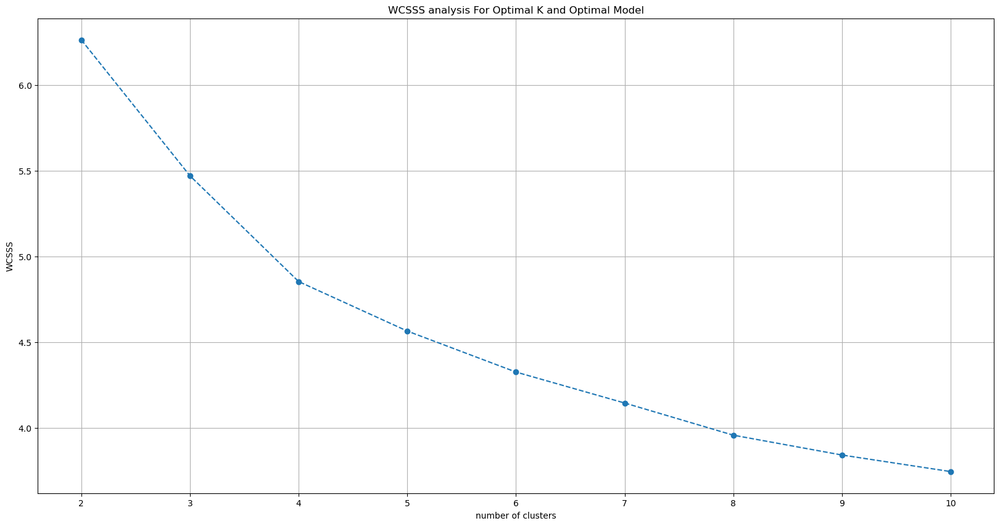

In [110]:
wcss=kmeans_wcsss(X_train,"euclidean","euclidean_t_10_k_2",10)

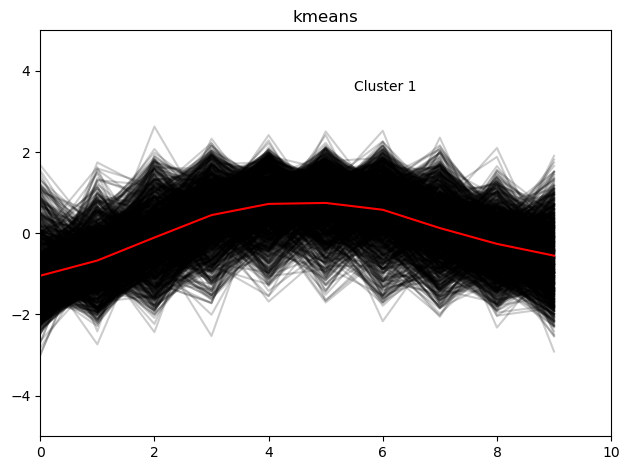

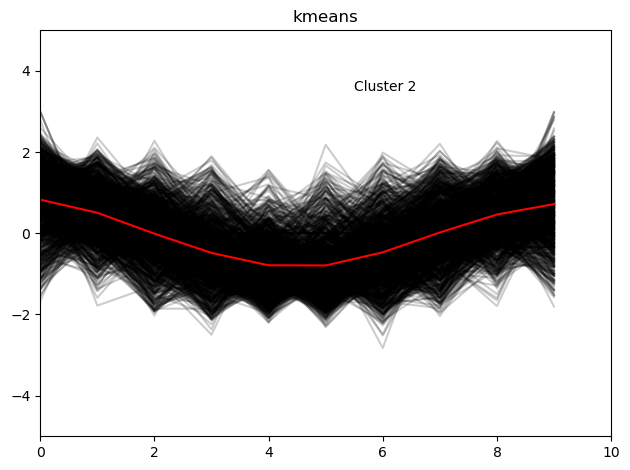

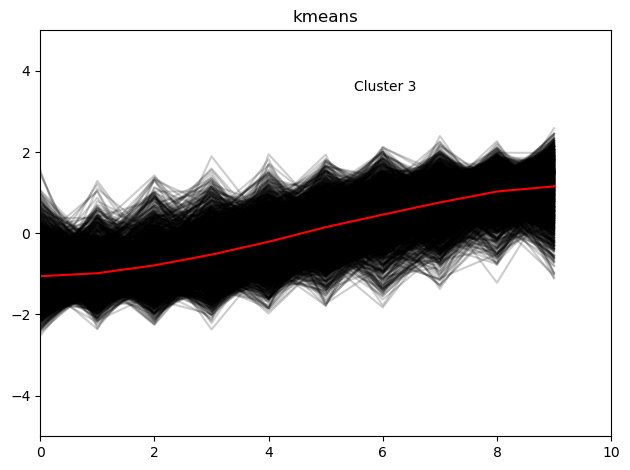

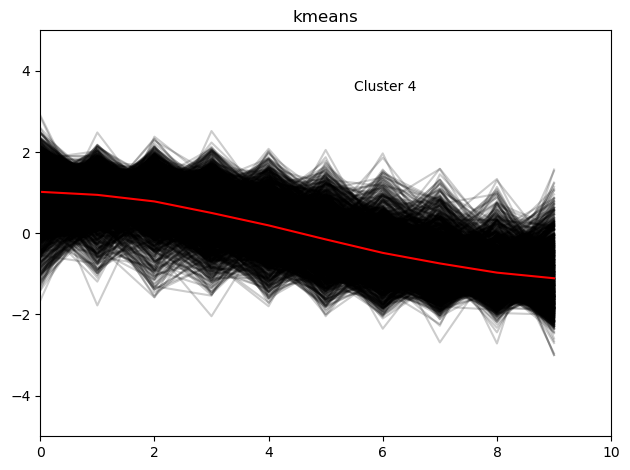

The 17.69% of the observations fall into Cluster 1
The 17.10% of the observations fall into Cluster 2
The 31.98% of the observations fall into Cluster 3
The 33.23% of the observations fall into Cluster 4


In [99]:
labels=kmeans_cluster(4,"kmeans_euclidean_10",X_train,"euclidean")

In [100]:
players_dict

{'dibil':      Unnamed: 0.1  Unnamed: 0 Player   Elo        Date      Time  \
 0         3047239     3746039  dibil  1779  2015.02.15  13:37:00   
 1        20334640     3746008  dibil  1787  2015.02.15  13:41:00   
 2         2886537     3553426  dibil  1773  2015.03.28  07:18:00   
 3        20173919     3553375  dibil  1768  2015.03.28  07:25:00   
 4         3558936     4355026  dibil  1787  2015.08.30  18:54:00   
 ..            ...         ...    ...   ...         ...       ...   
 403       8251605    10243422  dibil  1809  2018.01.05  13:48:00   
 404      25533255    10236985  dibil  1789  2018.01.07  21:20:00   
 405       8245195    10236251  dibil  1789  2018.01.08  08:30:00   
 406       8172647    10152471  dibil  1767  2018.02.07  10:07:00   
 407      16613872    10116702  dibil  1773  2018.02.21  17:35:00   
 
      FICSGamesDBGameNo  Year  Month  Day     Timestamp  
 0            372048956  2015      2   15  1.424007e+09  
 1            372049313  2015      2   15  1.

In [101]:
players=list(set(df.index))
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

with open(f"{PROJECT_PATH}/models/fics/player_series_labels_10_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)

#### other scoring

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"dtw")

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"softdtw")

In [ ]:
wcss=kmeans_wcsss(X,"euclidean")

In [ ]:
calinski_harabasz=kmeans_calinski_harabasz(X_train,"dtw")


In [ ]:
calinski_harabasz=kmeans_calinski_harabasz(X_train,"softdtw")

In [ ]:
calinski_harabasz=kmeans_calinski_harabasz(X_train,"euclidean")

## length 25 timeseries

In [111]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,25)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,25)).T

{'dibil': 50    1.455269e+09
51    1.455461e+09
52    1.455473e+09
53    1.455473e+09
54    1.455473e+09
55    1.455473e+09
56    1.455473e+09
57    1.455473e+09
58    1.455473e+09
59    1.455473e+09
60    1.455473e+09
61    1.455526e+09
62    1.455533e+09
63    1.455534e+09
64    1.455534e+09
65    1.455535e+09
66    1.455753e+09
67    1.456051e+09
68    1.456117e+09
69    1.456245e+09
70    1.456263e+09
71    1.456264e+09
72    1.456654e+09
73    1.457240e+09
74    1.457241e+09
Name: Timestamp, dtype: float64, 'Phillimon': 50    1.478846e+09
51    1.478848e+09
52    1.478848e+09
53    1.479065e+09
54    1.479071e+09
55    1.479071e+09
56    1.479190e+09
57    1.479612e+09
58    1.479613e+09
59    1.479613e+09
60    1.479614e+09
61    1.479614e+09
62    1.479615e+09
63    1.479692e+09
64    1.479692e+09
65    1.479693e+09
66    1.479694e+09
67    1.479694e+09
68    1.480046e+09
69    1.480051e+09
70    1.480219e+09
71    1.480219e+09
72    1.480219e+09
73    1.480219e+09
74    1.48022

In [112]:

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
dibil,0.028092,-0.518133,0.184156,-0.284037,0.574316,0.964477,0.730380,0.652348,0.496284,0.418252,...,0.886445,1.120541,0.574316,-0.127973,0.028092,-0.752229,-0.440101,-1.376486,-2.468935,-3.093192
Phillimon,0.224809,-0.749363,0.299745,-0.449618,-1.348854,-1.423790,-1.873408,-2.397963,-1.423790,-0.524554,...,0.449618,0.224809,0.674427,0.449618,-0.149873,0.824300,0.749363,0.674427,0.599491,0.524554
Quylthulg,-2.441993,-1.908341,-1.481419,-1.054497,-0.627575,-0.200653,0.226269,-0.200653,0.226269,-1.054497,...,0.973382,-0.307384,0.332999,0.866651,1.293573,0.012808,0.546460,1.080112,1.613764,0.332999
grotgod,-0.266382,0.621558,1.213517,1.694484,2.064459,0.843542,1.028530,0.177588,1.213517,-0.118392,...,-0.858341,-1.598291,-1.154321,-0.710351,-0.266382,0.066595,-1.006331,-1.672286,-1.302311,-0.710351
rjsekhar,-1.639411,-1.399931,-1.160451,-0.920971,-0.715703,-0.510434,-0.339377,-0.168320,-0.544646,-0.818337,...,0.071160,0.276428,0.550120,0.994868,1.302771,1.405405,1.713308,1.508039,1.302771,1.644885


,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
dibil,0.740741,0.611111,0.777778,0.666667,0.870370,0.962963,0.907407,0.888889,0.851852,0.833333,...,0.944444,1.000000,0.870370,0.703704,0.740741,0.555556,0.629630,0.407407,0.148148,0.000000
Phillimon,0.636364,0.400000,0.654545,0.472727,0.254545,0.236364,0.127273,0.000000,0.236364,0.454545,...,0.690909,0.636364,0.745455,0.690909,0.545455,0.781818,0.763636,0.745455,0.727273,0.709091
Quylthulg,0.000000,0.131579,0.236842,0.342105,0.447368,0.552632,0.657895,0.552632,0.657895,0.342105,...,0.842105,0.526316,0.684211,0.815789,0.921053,0.605263,0.736842,0.868421,1.000000,0.684211
grotgod,0.376238,0.613861,0.772277,0.900990,1.000000,0.673267,0.722772,0.495050,0.772277,0.415842,...,0.217822,0.019802,0.138614,0.257426,0.376238,0.465347,0.178218,0.000000,0.099010,0.257426
rjsekhar,0.000000,0.071429,0.142857,0.214286,0.275510,0.336735,0.387755,0.438776,0.326531,0.244898,...,0.510204,0.571429,0.653061,0.785714,0.877551,0.908163,1.000000,0.938776,0.877551,0.979592


(6298, 25, 1) (6298, 25, 1)
CPU times: user 526 ms, sys: 5 µs, total: 526 ms
Wall time: 525 ms


#### dtw & normalized & wcsss

In [ ]:
wcss=kmeans_wcsss(X_train,"dtw","dtw_t_25_k_10",10)

In [ ]:
kmeans_cluster(13,"kmeans_dtw_25",X_train,"dtw")

#### softdtw & normalized & wcsss

In [ ]:
wcss=kmeans_wcsss(X_train,"softdtw","softdtw_t_25_k_10",10)

In [ ]:
kmeans_cluster(13,"kmeans_softdtw_25",X_train,"softdtw")

#### euclidean & normalized & wcsss

16.06785485957306
K = 2. Took 1.46 seconds to calculate.
14.207853698116194
K = 3. Took 3.16 seconds to calculate.
12.666987033570082
K = 4. Took 6.39 seconds to calculate.
11.9411877557568
K = 5. Took 6.60 seconds to calculate.
11.386015339088582
K = 6. Took 6.26 seconds to calculate.
10.93477493836052
K = 7. Took 7.46 seconds to calculate.
10.570077940818024
K = 8. Took 7.77 seconds to calculate.
10.247529114274375
K = 9. Took 7.18 seconds to calculate.
10.01848724565706
K = 10. Took 7.15 seconds to calculate.


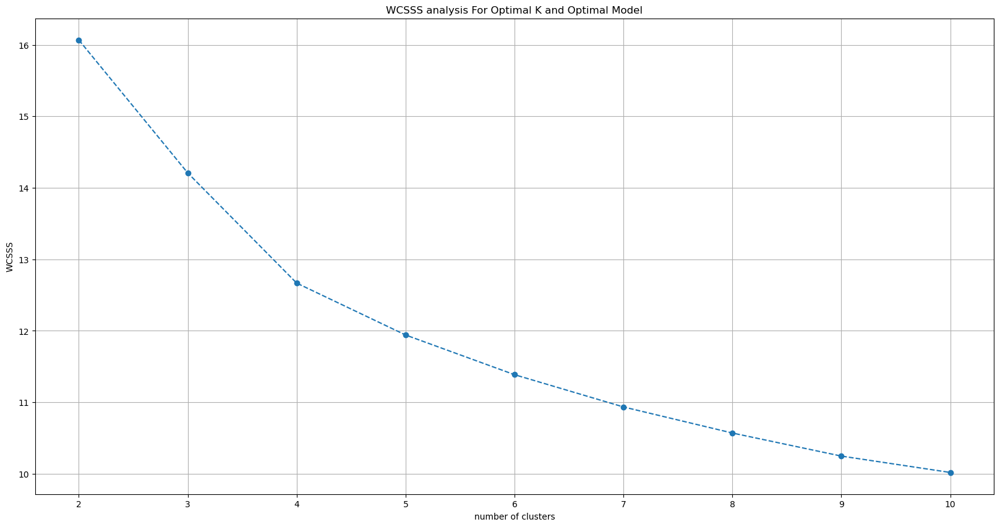

In [113]:
wcss=kmeans_wcsss(X_train,"euclidean","euclidean_t_25_k_10",10)

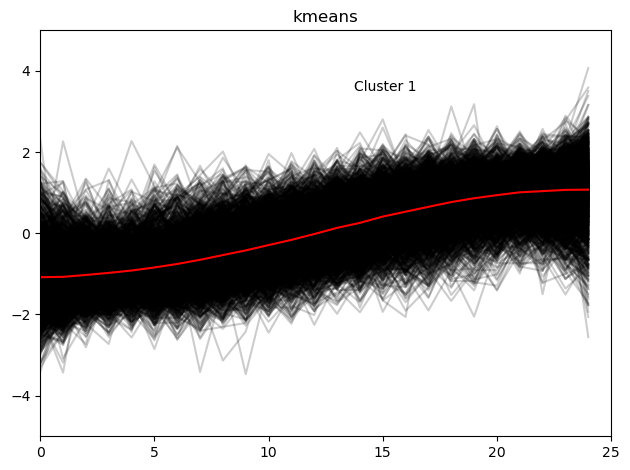

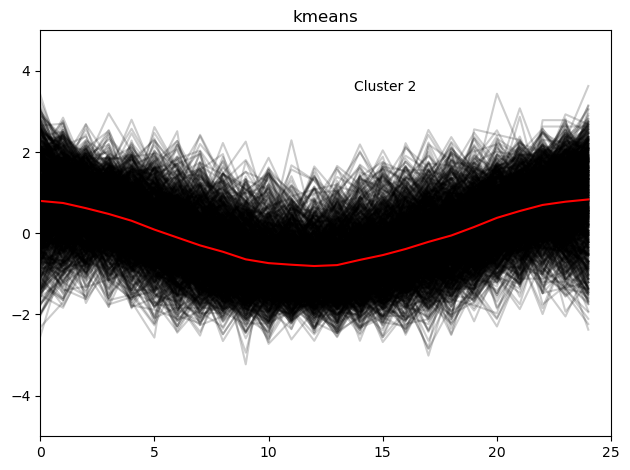

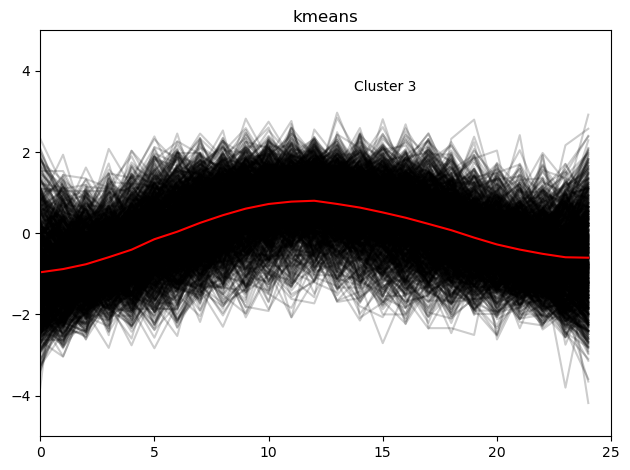

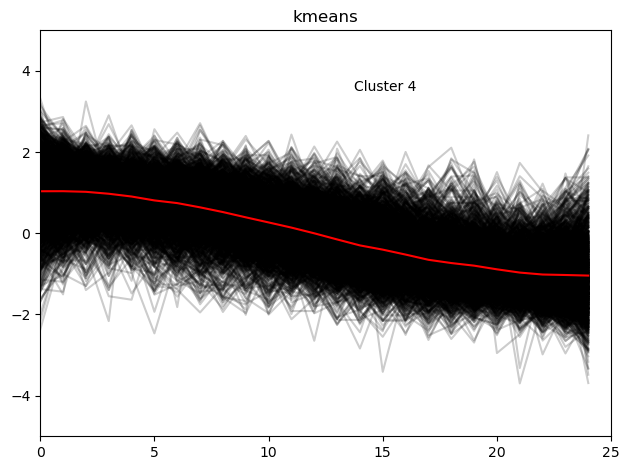

The 34.41% of the observations fall into Cluster 1
The 17.35% of the observations fall into Cluster 2
The 17.35% of the observations fall into Cluster 3
The 30.88% of the observations fall into Cluster 4


In [114]:
labels=kmeans_cluster(4,"kmeans_euclidean_25",X_train,"euclidean")

In [ ]:

players=list(set(df.index))
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}



In [115]:
players=list(set(df.index))

with open(f"{PROJECT_PATH}/models/fics/player_series_labels_25_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)

#### other scoring

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"dtw")

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"softdtw")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"dtw")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"softdtw")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"euclidean")

## length 50 timeseries

In [116]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,50)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,50)).T
display(df.head())

{'dibil': 50    1.455269e+09
51    1.455461e+09
52    1.455473e+09
53    1.455473e+09
54    1.455473e+09
55    1.455473e+09
56    1.455473e+09
57    1.455473e+09
58    1.455473e+09
59    1.455473e+09
60    1.455473e+09
61    1.455526e+09
62    1.455533e+09
63    1.455534e+09
64    1.455534e+09
65    1.455535e+09
66    1.455753e+09
67    1.456051e+09
68    1.456117e+09
69    1.456245e+09
70    1.456263e+09
71    1.456264e+09
72    1.456654e+09
73    1.457240e+09
74    1.457241e+09
75    1.457288e+09
76    1.457314e+09
77    1.457315e+09
78    1.457315e+09
79    1.457315e+09
80    1.457315e+09
81    1.457603e+09
82    1.457946e+09
83    1.457958e+09
84    1.458014e+09
85    1.458098e+09
86    1.459932e+09
87    1.460102e+09
88    1.460265e+09
89    1.460287e+09
90    1.460350e+09
91    1.460439e+09
92    1.460462e+09
93    1.460472e+09
94    1.460736e+09
95    1.460737e+09
96    1.460793e+09
97    1.461043e+09
98    1.461164e+09
99    1.465394e+09
Name: Timestamp, dtype: float64, 'Philli

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
dibil,1783,1776,1785,1779,1790,1795,1792,1791,1789,1788,...,1776,1785,1793,1781,1782,1768,1760,1756,1742,1725
Phillimon,1513,1500,1514,1504,1492,1491,1485,1478,1491,1503,...,1554,1562,1557,1550,1558,1568,1567,1579,1571,1582
Quylthulg,2220,2225,2229,2233,2237,2241,2245,2241,2245,2233,...,2230,2227,2217,2207,2206,2212,2200,2206,2211,2216
grotgod,1488,1512,1528,1541,1551,1518,1523,1500,1528,1492,...,1538,1558,1563,1583,1598,1604,1615,1560,1575,1592
rjsekhar,1551,1558,1565,1572,1578,1584,1589,1594,1583,1575,...,1613,1607,1601,1595,1589,1584,1595,1589,1584,1579


In [117]:

%%time

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
dibil,0.442470,-0.005115,0.570351,0.186707,0.890055,1.209758,1.017936,0.953995,0.826114,0.762173,...,-0.005115,0.570351,1.081877,0.314588,0.378529,-0.516641,-1.028167,-1.283929,-2.179099,-3.266091
Phillimon,-0.454395,-0.992385,-0.413011,-0.826849,-1.323456,-1.364839,-1.613143,-1.902830,-1.364839,-0.868233,...,1.242343,1.573414,1.366495,1.076808,1.407879,1.821717,1.780333,2.276940,1.945869,2.401091
Quylthulg,-1.031579,-0.720488,-0.471615,-0.222741,0.026132,0.275005,0.523878,0.275005,0.523878,-0.222741,...,-0.409396,-0.596051,-1.218234,-1.840417,-1.902635,-1.529325,-2.275944,-1.902635,-1.591543,-1.280452
grotgod,-0.446929,0.047370,0.376903,0.644649,0.850607,0.170945,0.273924,-0.199779,0.376903,-0.364546,...,0.582861,0.994777,1.097756,1.509672,1.818610,1.942184,2.168738,1.035969,1.344906,1.695035
rjsekhar,-2.084744,-1.827821,-1.570899,-1.313976,-1.093757,-0.873537,-0.690021,-0.506505,-0.910240,-1.203866,...,0.190857,-0.029363,-0.249582,-0.469801,-0.690021,-0.873537,-0.469801,-0.690021,-0.873537,-1.057053


,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
dibil,0.805556,0.708333,0.833333,0.750000,0.902778,0.972222,0.930556,0.916667,0.888889,0.875000,...,0.708333,0.833333,0.944444,0.777778,0.791667,0.597222,0.486111,0.430556,0.236111,0.000000
Phillimon,0.336538,0.211538,0.346154,0.250000,0.134615,0.125000,0.067308,0.000000,0.125000,0.240385,...,0.730769,0.807692,0.759615,0.692308,0.769231,0.865385,0.855769,0.971154,0.894231,1.000000
Quylthulg,0.307692,0.384615,0.446154,0.507692,0.569231,0.630769,0.692308,0.630769,0.692308,0.507692,...,0.461538,0.415385,0.261538,0.107692,0.092308,0.184615,0.000000,0.092308,0.169231,0.246154
grotgod,0.328042,0.455026,0.539683,0.608466,0.661376,0.486772,0.513228,0.391534,0.539683,0.349206,...,0.592593,0.698413,0.724868,0.830688,0.910053,0.941799,1.000000,0.708995,0.788360,0.878307
rjsekhar,0.000000,0.070000,0.140000,0.210000,0.270000,0.330000,0.380000,0.430000,0.320000,0.240000,...,0.620000,0.560000,0.500000,0.440000,0.380000,0.330000,0.440000,0.380000,0.330000,0.280000


(6298, 50, 1) (6298, 50, 1)
CPU times: user 592 ms, sys: 0 ns, total: 592 ms
Wall time: 592 ms


#### dtw & normalized & wcsss

In [ ]:
wcss=kmeans_wcsss(X_train,"dtw","dtw_t_50_k_10",10)

In [ ]:
kmeans_cluster(9,"kmeans_dtw_50",X_train,"dtw")

#### softdtw & normalized & wcsss

In [ ]:
wcss=kmeans_wcsss(X_train,"softdtw",20)

In [ ]:
kmeans_cluster(13,"kmeans_softdtw_50",X_train,"softdtw")

#### euclidean & normalized & wcsss

32.975529014551675
K = 2. Took 1.22 seconds to calculate.
29.198741783077512
K = 3. Took 2.13 seconds to calculate.
26.2385038940421
K = 4. Took 3.82 seconds to calculate.
24.749996951562984
K = 5. Took 8.20 seconds to calculate.
23.797695414792965
K = 6. Took 8.06 seconds to calculate.
22.84072284644903
K = 7. Took 7.72 seconds to calculate.
22.086937317893497
K = 8. Took 7.99 seconds to calculate.
21.590069066379762
K = 9. Took 5.07 seconds to calculate.
21.03478014437163
K = 10. Took 7.84 seconds to calculate.


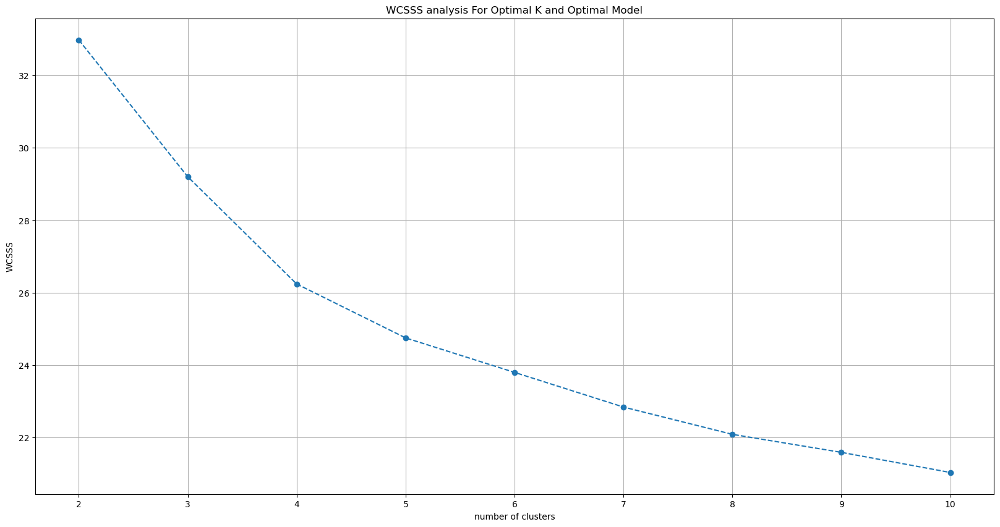

In [119]:
wcss=kmeans_wcsss(X_train,"euclidean","euclidean_t_50_k_10",10)

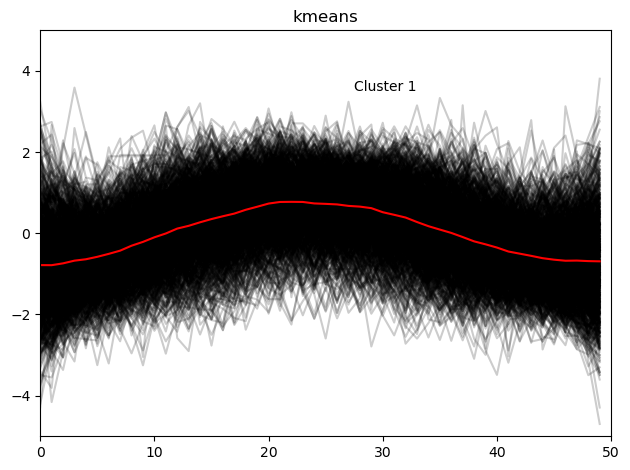

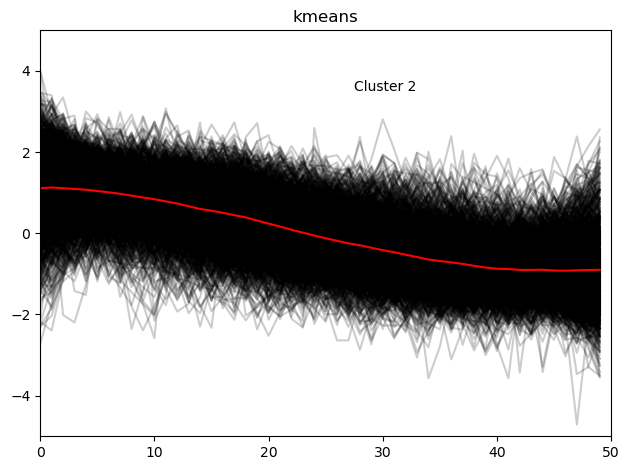

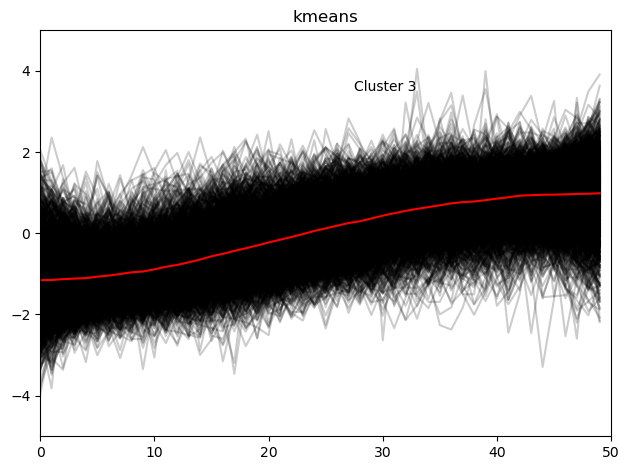

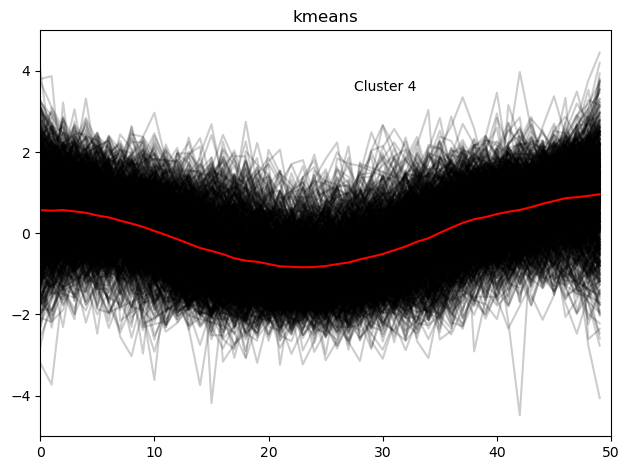

The 18.18% of the observations fall into Cluster 1
The 28.56% of the observations fall into Cluster 2
The 35.76% of the observations fall into Cluster 3
The 17.50% of the observations fall into Cluster 4


In [121]:
labels=kmeans_cluster(4,"kmeans_euclidean_50",X_train,"euclidean")
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

with open(f"{PROJECT_PATH}/models/fics/player_series_labels_50_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)



#### other scoring

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"dtw")

In [ ]:
silhoutte=kmeans_silhoutte(X_train,"softdtw")

In [ ]:
wcss=kmeans_wcsss(X,"euclidean")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"dtw")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"softdtw")

In [ ]:
silhoutte=kmeans_calinski_harabasz(X_train,"euclidean")

## Analyze cluster

In [7]:
df=pd.DataFrame.from_dict(get_samples(players_dict,50,150)).T
df_ts=pd.DataFrame.from_dict(get_samples_ts(players_dict,50,150)).T


{'dibil': 50     1.455269e+09
51     1.455461e+09
52     1.455473e+09
53     1.455473e+09
54     1.455473e+09
           ...     
195    1.468931e+09
196    1.469195e+09
197    1.469362e+09
198    1.469362e+09
199    1.469363e+09
Name: Timestamp, Length: 150, dtype: float64, 'Phillimon': 50     1.478846e+09
51     1.478848e+09
52     1.478848e+09
53     1.479065e+09
54     1.479071e+09
           ...     
195    1.498701e+09
196    1.498741e+09
197    1.498753e+09
198    1.499018e+09
199    1.499095e+09
Name: Timestamp, Length: 150, dtype: float64, 'Quylthulg': 50     1.422005e+09
51     1.422005e+09
52     1.422006e+09
53     1.422006e+09
54     1.422009e+09
           ...     
195    1.430155e+09
196    1.430156e+09
197    1.430156e+09
198    1.430211e+09
199    1.430212e+09
Name: Timestamp, Length: 150, dtype: float64, 'grotgod': 50     1.475202e+09
51     1.477533e+09
52     1.478481e+09
53     1.478567e+09
54     1.478567e+09
           ...     
195    1.553237e+09
196    1.553683

In [6]:
# Normalization is a rescaling of the data from the original range so that all values are within the range of 0 and 1.
# Taken from https://machinelearningmastery.com/how-to-improve-neural-network-stability-and-modeling-performance-with-data-scaling/
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df_ma.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df_ma.columns, index=df_ma.index)
X_mm = df_mm.values
df_mm.head()

NameError: name 'df_ma' is not defined

In [10]:
df

,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
dibil,1783,1776,1785,1779,1790,1795,1792,1791,1789,1788,...,1472,1466,1472,1482,1476,1466,1461,1456,1451,1446
Phillimon,1513,1500,1514,1504,1492,1491,1485,1478,1491,1503,...,1579,1588,1587,1588,1589,1567,1560,1571,1561,1557
Quylthulg,2220,2225,2229,2233,2237,2241,2245,2241,2245,2233,...,2116,2122,2113,2120,2127,2134,2125,2132,2139,2145
grotgod,1488,1512,1528,1541,1551,1518,1523,1500,1528,1492,...,2058,2061,2048,2051,2056,2059,2065,2067,2074,2082
rjsekhar,1551,1558,1565,1572,1578,1584,1589,1594,1583,1575,...,1557,1568,1563,1558,1569,1575,1565,1556,1547,1542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
wasponer,1356,1363,1371,1363,1357,1365,1371,1362,1362,1354,...,1409,1404,1407,1398,1407,1416,1409,1402,1408,1418
supajut,1577,1582,1569,1557,1545,1542,1551,1559,1561,1551,...,1707,1695,1698,1701,1709,1717,1706,1698,1690,1697
debmajdic,1181,1175,1174,1172,1165,1160,1147,1145,1162,1159,...,1071,1071,1071,1070,1060,1051,1052,1062,1071,1062
homerg,1666,1657,1649,1641,1636,1630,1622,1616,1626,1636,...,1893,1892,1891,1897,1913,1930,1945,1962,1972,1983


In [11]:

# Standardizing (z-score normalization) a dataset involves rescaling the distribution of values
ss = StandardScaler()

scaled_ss = ss.fit_transform(df.T)
df_ss = pd.DataFrame(scaled_ss.T, columns=df.columns, index=df.index)
X_ss = df_ss.values
display(df_ss.head())

# Normalization
mm = MinMaxScaler()
scaled_mm = mm.fit_transform(df.T)
df_mm = pd.DataFrame(scaled_mm.T, columns=df.columns, index=df.index)
X_mm = df_mm.values
display(df_mm.head())


# convert dataframe to time_series_dataset
X = to_time_series_dataset(df.values)

# normalize time series to zero mean and unit variance
X_train = TimeSeriesScalerMeanVariance().fit_transform(X)

print(X.shape, X_train.shape)

,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
dibil,1.177641,1.109055,1.197236,1.138449,1.246226,1.295215,1.265822,1.256024,1.236428,1.226630,...,-1.869502,-1.928289,-1.869502,-1.771523,-1.830310,-1.928289,-1.977279,-2.026268,-2.075257,-2.124247
Phillimon,-1.477487,-1.801133,-1.452591,-1.701549,-2.000300,-2.025196,-2.174571,-2.348842,-2.025196,-1.726445,...,0.165640,0.389703,0.364807,0.389703,0.414599,-0.133110,-0.307381,-0.033526,-0.282485,-0.382069
Quylthulg,0.799223,0.900288,0.981140,1.061993,1.142845,1.223697,1.304549,1.223697,1.304549,1.061993,...,-1.302932,-1.181654,-1.363571,-1.222080,-1.080589,-0.939097,-1.121015,-0.979523,-0.838032,-0.716754
grotgod,-1.216916,-1.112037,-1.042118,-0.985309,-0.941609,-1.085818,-1.063968,-1.164477,-1.042118,-1.199437,...,1.273959,1.287069,1.230259,1.243369,1.265219,1.278329,1.304549,1.313289,1.343878,1.378838
rjsekhar,-0.559862,-0.361061,-0.162260,0.036542,0.206943,0.377344,0.519345,0.661345,0.348944,0.121742,...,-0.389461,-0.077059,-0.219060,-0.361061,-0.048659,0.121742,-0.162260,-0.417861,-0.673463,-0.815464


,0,1,2,3,4,5,6,7,8,9,...,140,141,142,143,144,145,146,147,148,149
dibil,0.960114,0.940171,0.965812,0.948718,0.980057,0.994302,0.985755,0.982906,0.977208,0.974359,...,0.074074,0.056980,0.074074,0.102564,0.085470,0.056980,0.042735,0.028490,0.014245,0.000000
Phillimon,0.228758,0.143791,0.235294,0.169935,0.091503,0.084967,0.045752,0.000000,0.084967,0.163399,...,0.660131,0.718954,0.712418,0.718954,0.725490,0.581699,0.535948,0.607843,0.542484,0.516340
Quylthulg,0.723926,0.754601,0.779141,0.803681,0.828221,0.852761,0.877301,0.852761,0.877301,0.803681,...,0.085890,0.122699,0.067485,0.110429,0.153374,0.196319,0.141104,0.184049,0.226994,0.263804
grotgod,0.094512,0.131098,0.155488,0.175305,0.190549,0.140244,0.147866,0.112805,0.155488,0.100610,...,0.963415,0.967988,0.948171,0.952744,0.960366,0.964939,0.974085,0.977134,0.987805,1.000000
rjsekhar,0.328859,0.375839,0.422819,0.469799,0.510067,0.550336,0.583893,0.617450,0.543624,0.489933,...,0.369128,0.442953,0.409396,0.375839,0.449664,0.489933,0.422819,0.362416,0.302013,0.268456


(5933, 150, 1) (5933, 150, 1)


In [14]:
wcss=kmeans_wcsss(X_train,"dtw",f"kmeans_dtw_150",20)

KeyboardInterrupt: 

In [ ]:
kmeans_cluster(4,f"kmeans_dtw_150",X_train,"dtw")

In [ ]:
wcss=kmeans_wcsss(X_train,"softdtw",f"kmeans_softdtw_150",10)

106.21690690944742
K = 2. Took 1.76 seconds to calculate.
95.33683364904373
K = 3. Took 5.73 seconds to calculate.
87.29811791992877
K = 4. Took 6.39 seconds to calculate.
83.48871512900833
K = 5. Took 7.26 seconds to calculate.
79.66244148624133
K = 6. Took 7.25 seconds to calculate.
76.75500942953934
K = 7. Took 6.89 seconds to calculate.
74.95331030264248
K = 8. Took 5.26 seconds to calculate.
72.62154611569775
K = 9. Took 7.16 seconds to calculate.
71.48637501553796
K = 10. Took 7.21 seconds to calculate.


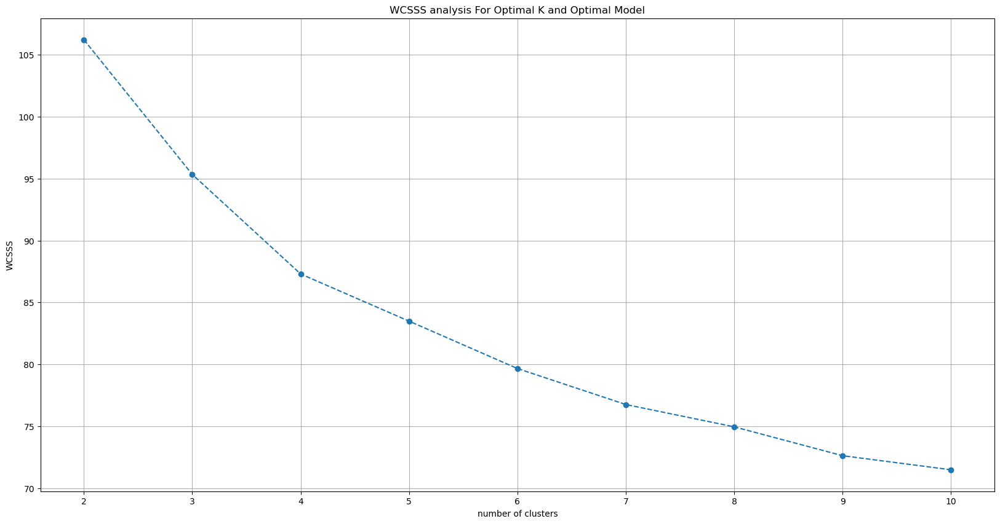

In [129]:
wcss=kmeans_wcsss(X_train,"euclidean",f"kmeans_euclidean_150",10)

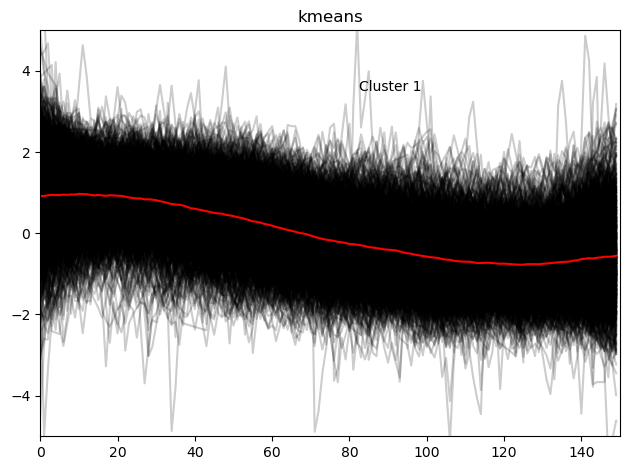

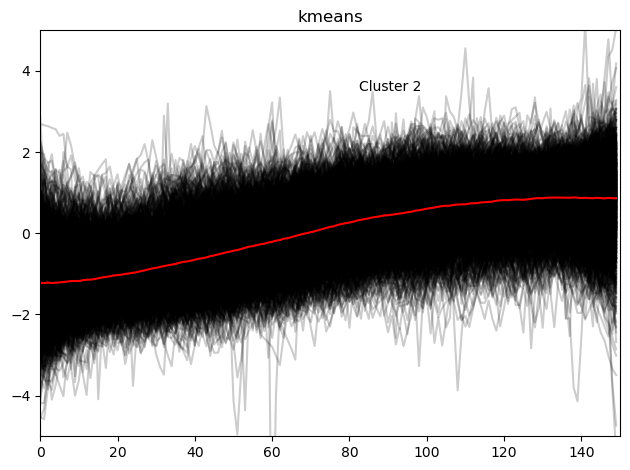

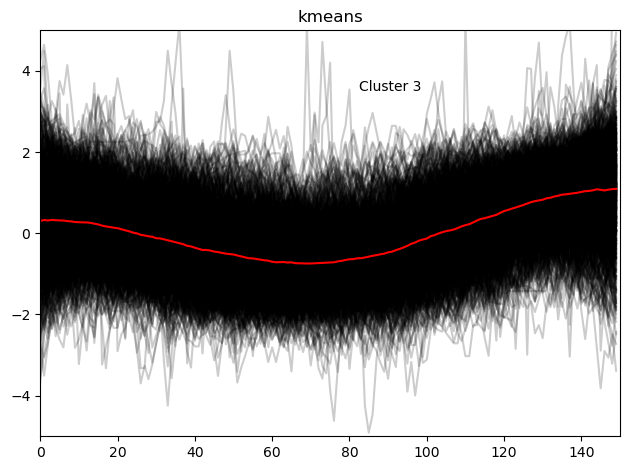

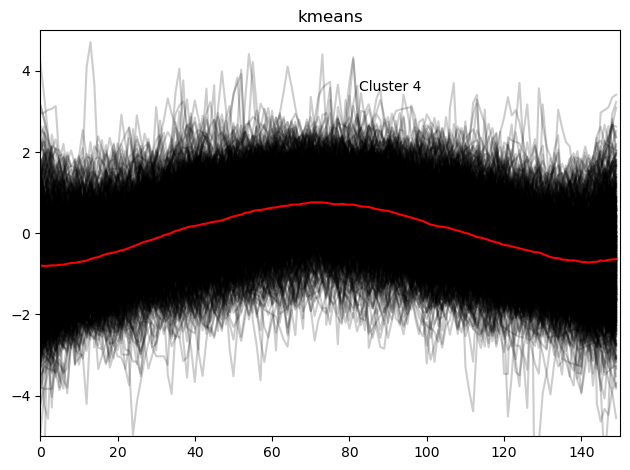

The 26.26% of the observations fall into Cluster 1
The 34.92% of the observations fall into Cluster 2
The 20.01% of the observations fall into Cluster 3
The 18.81% of the observations fall into Cluster 4


In [131]:
labels=kmeans_cluster(4,f"kmeans_euclidean_150",X_train,"euclidean")

In [137]:
players=list(set(df.index))
player_series_labels={players[i]:{'label':[labels[i]],
                                  'games':list(df[df.index==players[i]].values[0]),
                                  'ts':list(df_ts[df_ts.index==players[i]].values[0])
                                  } for i in range(len(players))}

In [138]:
with open(f"{PROJECT_PATH}/models/fics/player_series_labels_150_euclidean.pkl", 'wb') as f:
    pickle.dump(player_series_labels, f)

: 

In [ ]:
wcss=kmeans_wcsss(X_train,"dtw",f"kmeans_dtw_150",10)

In [ ]:
kmeans_cluster(4,f"kmeans_dtw_150",X_train,"dtw")